In [100]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [101]:
# !pip install blend-modes
# !pip install opensimplex
!pip install perlin-noise

Defaulting to user installation because normal site-packages is not writeable


In [102]:
from dataset import COCOPanopticDataset, COCODataLoader
from copy import copy, deepcopy
import json
from PIL import Image, ImageFilter, ImageDraw
import pickle as pkl
import random
import blend_modes as bm
import numpy as np
from scipy.ndimage import gaussian_filter
from torchvision.transforms.functional import to_tensor, to_pil_image
from torch.nn.functional import conv2d
import torch
import math

In [103]:
def crop_and_resize(x, size=512, resample=Image.BICUBIC):
    if x.size == (size, size):
        return x
    w, h = x.size
    print(w, h)
    s = min(w, h)
    # compute maximum centercrop
    w_remain, h_remain = w - s, h - s
    x = x.crop((round(w_remain / 2), round(h_remain / 2), w - (w_remain - round(w_remain / 2)), h - (h_remain - round(h_remain / 2))))
    print(x.size)
    x = x.resize((size, size), resample=resample)
    print(x.size)
    return x
    
    
def prep_dev_ex(example, caption=None, swaps=None):
    example.image_data = crop_and_resize(example.load_image())
    example.image_path = None
    example.seg_data = crop_and_resize(example.load_seg_image(), resample=Image.NEAREST)
    example.seg_path = None
    example.cropsize = 512
    if caption is not None:
        example.captions = [caption]
    
    example2 = deepcopy(example)
    
    swaps = {} if swaps is None else swaps
    
    for k in example2.seg_info:
        v = example2.seg_info[k]
        if v["caption"] in swaps:
            print(f'{k} swapping: {v} --> {swaps[v["caption"]]}')
            example2.seg_info[k]["caption"] = swaps[v["caption"]]
            
    return example, example2


def display_example(example, seg_only=False):
    print(example.id)
    display(example.load_seg_image())
    if not seg_only:
        display(example.load_image())
    if not seg_only:
        print(json.dumps(example.seg_info, indent=4))
    
    
def blend(base, overlay, opacity=0.7):
    base = np.array(base.convert("RGBA")).astype(float)
    overlay = np.array(overlay.convert("RGBA")).astype(float)
    blended = bm.hard_light(base, overlay, opacity)
    blended_pil = Image.fromarray(np.uint8(blended))
    return blended_pil

def gaussian_blur(pilimg, radius=5):
    ret = pilimg.filter(ImageFilter.GaussianBlur(radius=radius))
    return ret


In [5]:
ds = COCOPanopticDataset(maindir="/USERSPACE/lukovdg1/coco2017", split="train", casmode="global")
print(len(ds))

loading captions
loading panoptics
Creating examples


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 118287/118287 [00:00<00:00, 162494.24it/s]


Size stats:
{448: 43836, 512: 8442, 384: 45521}
Retained examples: 81636
Too many regions: 15322
Too few regions: 841
Too small: 20488
81636


In [6]:
len(ds)

81636

931
83923


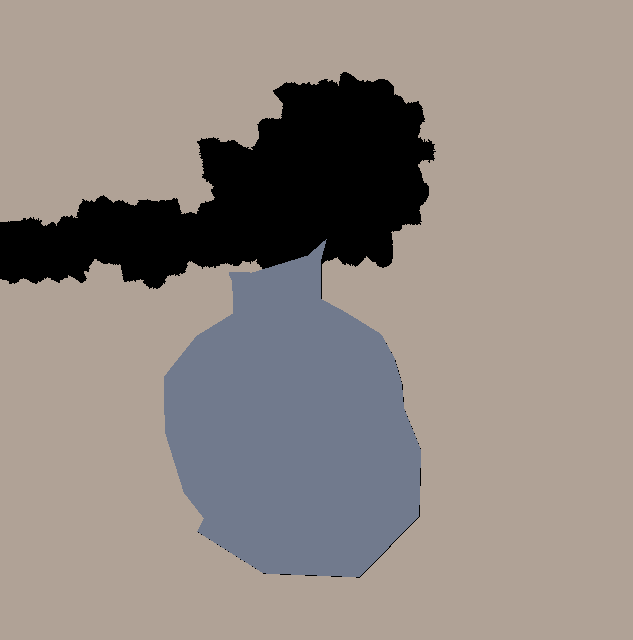

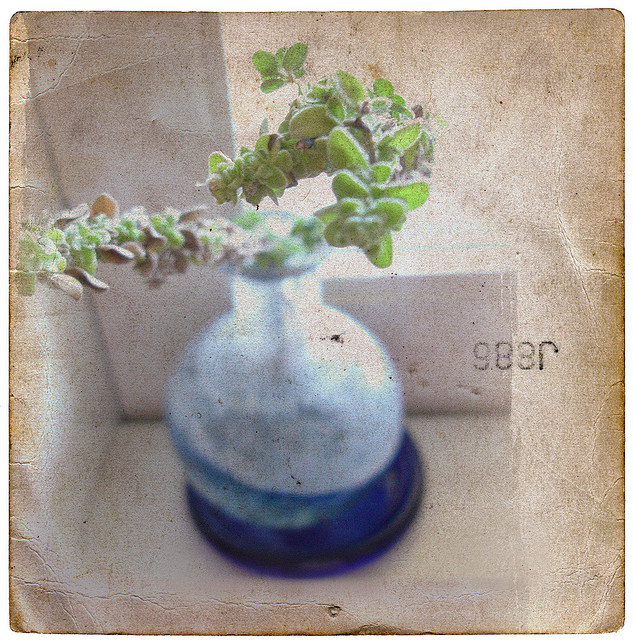

{
    "9271921": {
        "category_id": 86,
        "caption": "vase"
    },
    "9872048": {
        "category_id": 195,
        "caption": "paper"
    }
}


In [7]:
i = 626
i = random.randint(0, len(ds.examples[2][1]))
print(i)

interestingexample = deepcopy(ds.examples[2][1][i])    # 6853 , 3632, 3343, 2777, 6722, 4359, 5022, 5626, 6648, 2209, 1017, 812, 6332, 6123, 6856, 1352, 2836, 147, 3363, 141, 2269
# clearer shapes: 1035, 6485, 2740, 5589, 4964, 7243, 6306, 2747


display_example(interestingexample)

2740
{3495320, 13676172}
358118


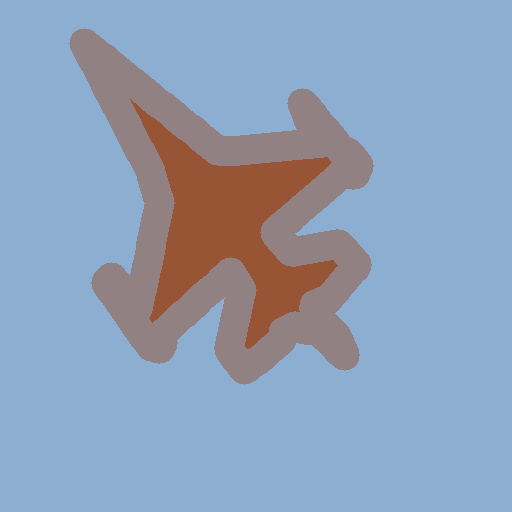

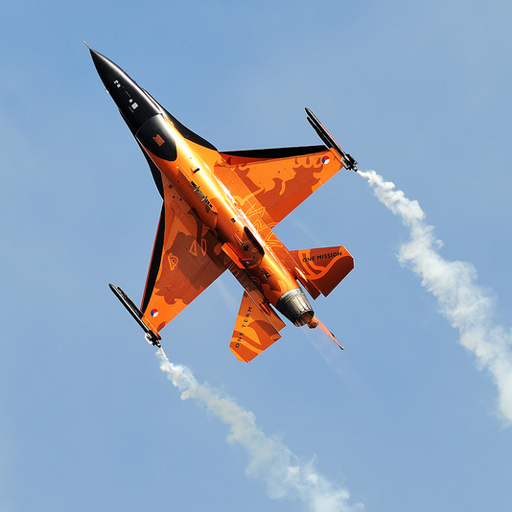

{
    "3495320": {
        "category_id": 5,
        "caption": "airplane"
    },
    "13676172": {
        "category_id": 187,
        "caption": "sky"
    }
}
7243
{13685973, 8947325, 14079703}
464809


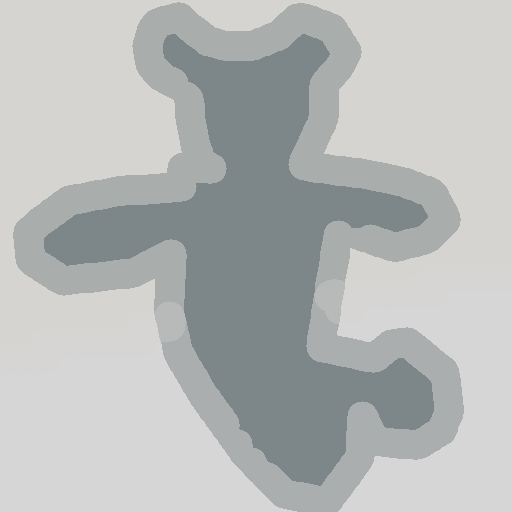

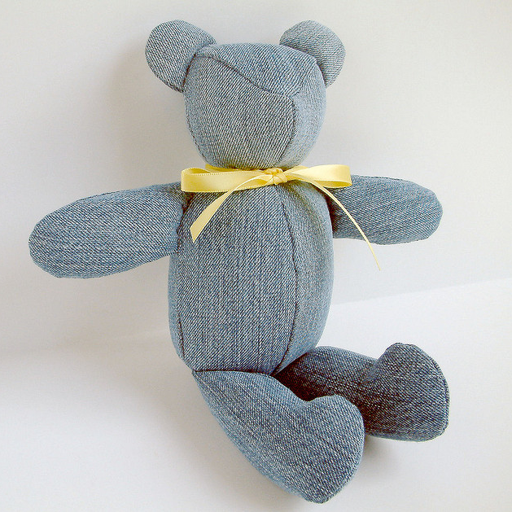

{
    "8947325": {
        "category_id": 88,
        "caption": "teddy bear"
    },
    "14079703": {
        "category_id": 190,
        "caption": "floor"
    },
    "13685973": {
        "category_id": 199,
        "caption": "wall"
    }
}
2747
{2508129, 3913426}
557119


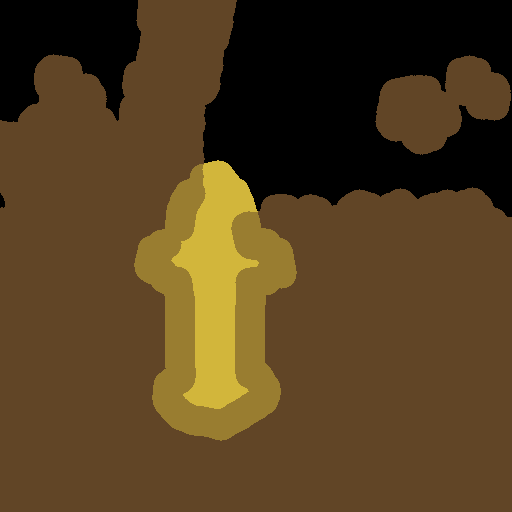

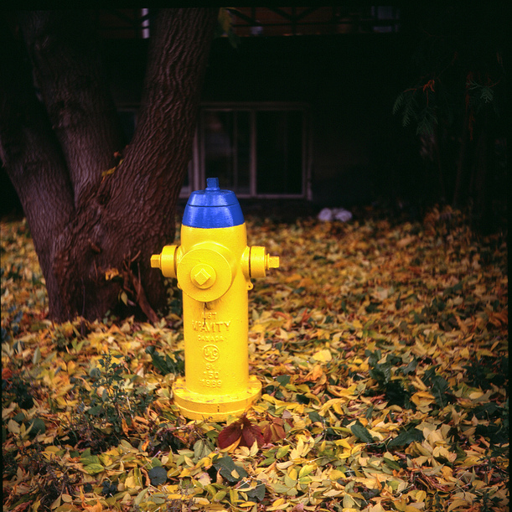

{
    "3913426": {
        "category_id": 11,
        "caption": "fire hydrant"
    },
    "2508129": {
        "category_id": 184,
        "caption": "tree"
    }
}
1035
{3166337, 15584161, 9079948, 3432795, 11708318}
150098


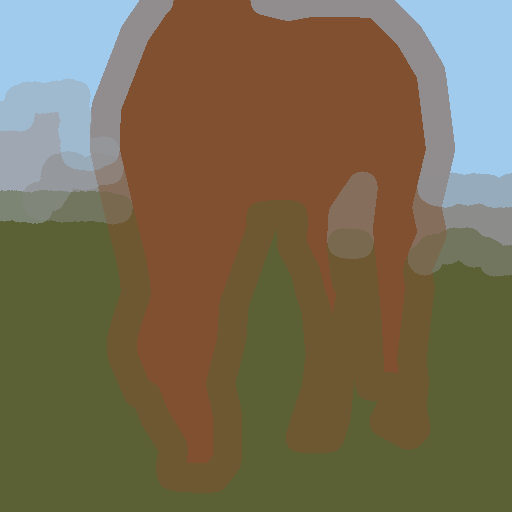

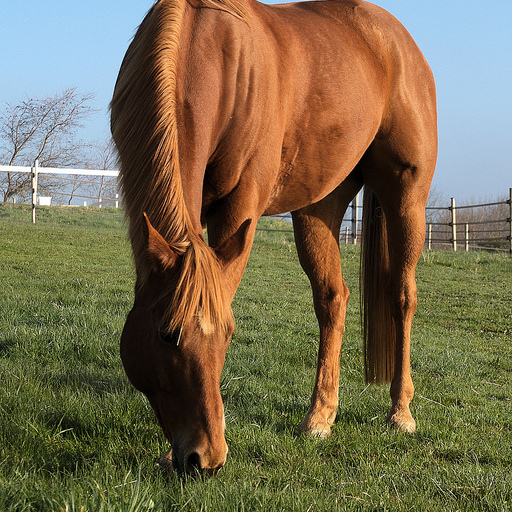

{
    "3166337": {
        "category_id": 19,
        "caption": "horse"
    },
    "11708318": {
        "category_id": 184,
        "caption": "tree"
    },
    "9079948": {
        "category_id": 185,
        "caption": "fence"
    },
    "15584161": {
        "category_id": 187,
        "caption": "sky"
    },
    "3432795": {
        "category_id": 193,
        "caption": "grass"
    }
}
6485
{11712962, 4217212}
492235


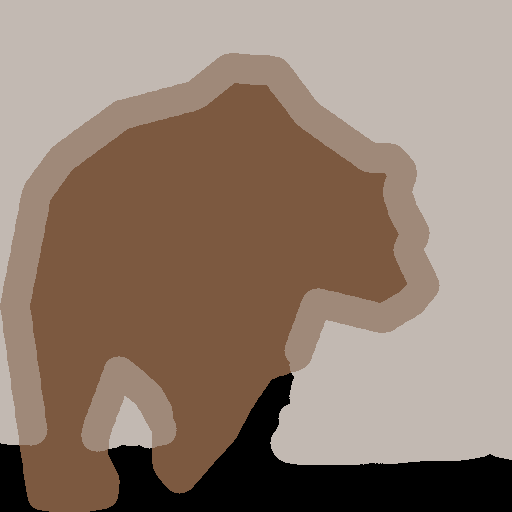

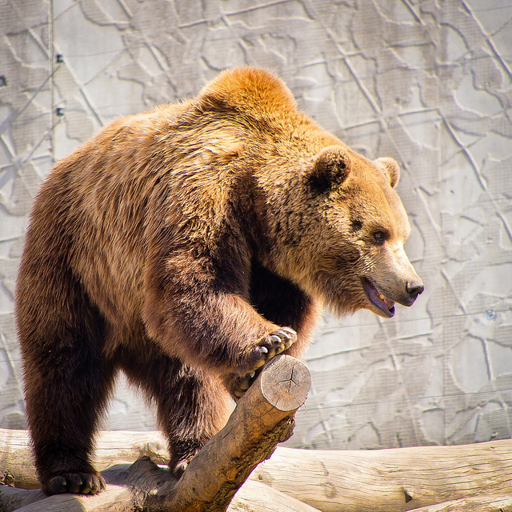

{
    "4217212": {
        "category_id": 23,
        "caption": "bear"
    },
    "11712962": {
        "category_id": 199,
        "caption": "wall"
    }
}
5589
{2761785, 15788506, 3718052}
218875


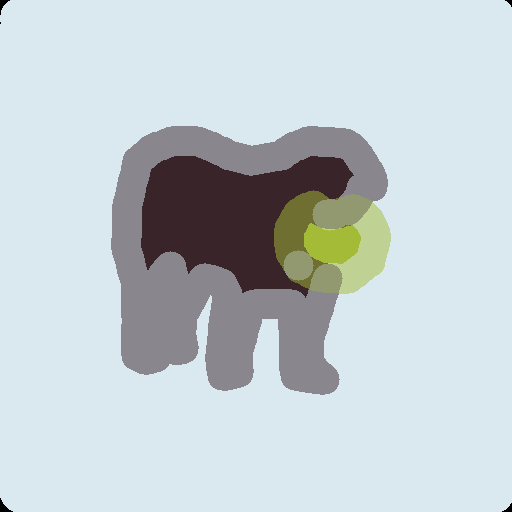

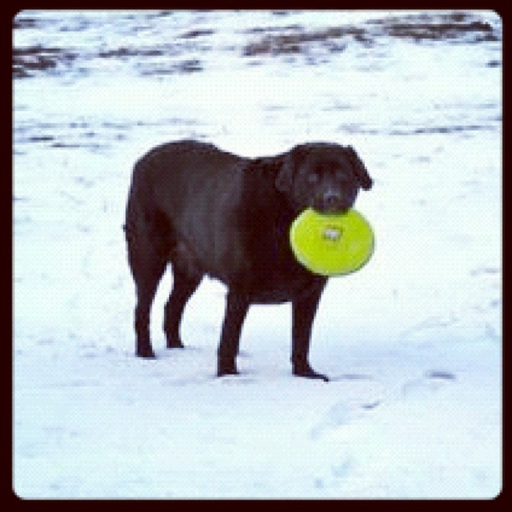

{
    "2761785": {
        "category_id": 18,
        "caption": "dog"
    },
    "3718052": {
        "category_id": 34,
        "caption": "frisbee"
    },
    "15788506": {
        "category_id": 159,
        "caption": "snow"
    }
}
4964
{14730416, 2171707, 10064781}
82513


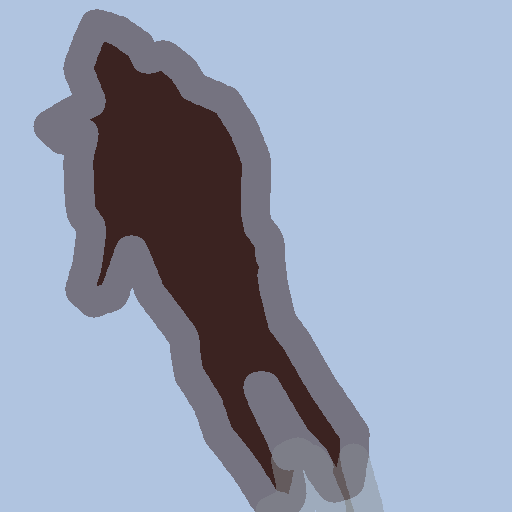

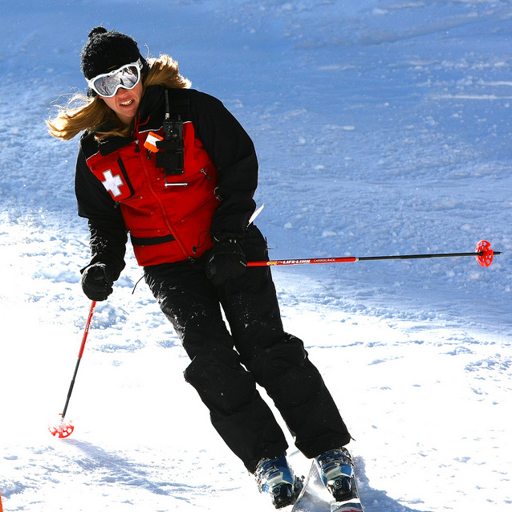

{
    "2171707": {
        "category_id": 1,
        "caption": "person"
    },
    "10064781": {
        "category_id": 35,
        "caption": "skis"
    },
    "14730416": {
        "category_id": 159,
        "caption": "snow"
    }
}
6306
{3429728, 7766939, 1580068}
178184


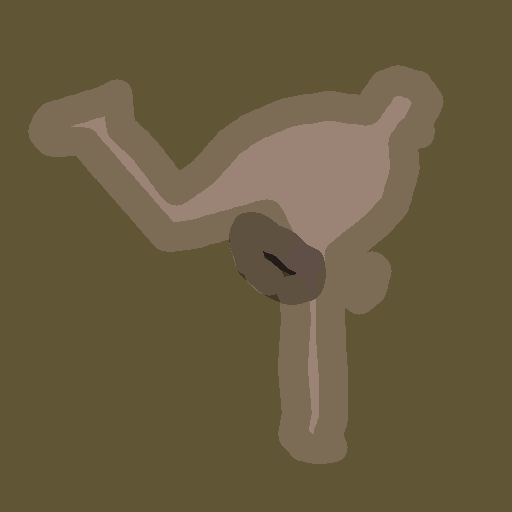

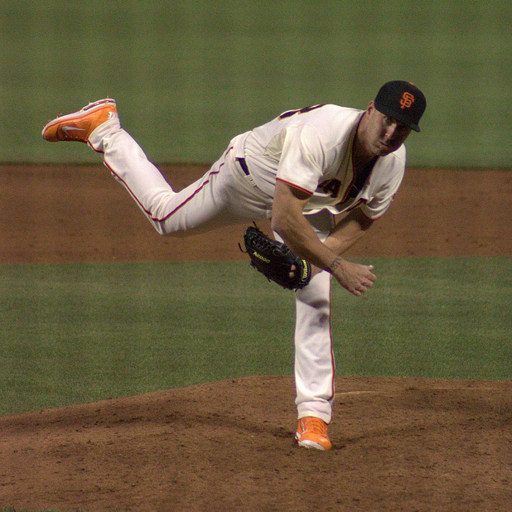

{
    "7766939": {
        "category_id": 1,
        "caption": "person"
    },
    "1580068": {
        "category_id": 40,
        "caption": "baseball glove"
    },
    "3429728": {
        "category_id": 145,
        "caption": "playingfield"
    }
}


In [15]:

def hardblur(pilimg, radius=5, colors=None):    # if colors is None, then we do all of them
#     print(pilimg.size)
#     print(pilimg.getpixel((0, 0)))
#     uniquecolors = set()
#     for i in range(pilimg.size[0]):
#         for j in range(pilimg.size[1]):
#             uniquecolors.add(pilimg.getpixel((i, j)))
            
#     if colors is None:
#         colors = uniquecolors
        
    img = to_tensor(pilimg)
    intimg = (img * 255).to(torch.long)
    colorcodes = intimg[2] * 256*256 + intimg[1] * 256 + intimg[0]
    uniquecolorcodes = set(colorcodes.unique().cpu().numpy()) - {0}
    print(uniquecolorcodes)
#     print(uniquecolorcodes)
    if colors is None:
        colors = uniquecolorcodes
        
    uniquecolorcodes = uniquecolorcodes
    
    # create uniform circular kernel
    kernel = torch.zeros(1, 1, radius * 2 + 1, radius * 2 + 1)
    for i in range(kernel.shape[2]):
        for j in range(kernel.shape[3]):
            x, y = i - radius, j - radius
            if math.sqrt(x**2 + y**2) <= radius:
                kernel[:, :, i, j] = 1
#     kernel = kernel.float() / kernel.sum()
#     print(kernel[0, 0])
    
    # generate separate masks for every color
    colorimgs = []
    for colorcode in colors:
        colorimg = (colorcodes == colorcode).float()
#         display(to_pil_image(colorimg))
        colorimg = (conv2d(colorimg[None], kernel, padding="same") > 0).float()
#         display(to_pil_image(colorimg))
        colorimgs.append(colorimg)
        
    # merge masks into overlapping colors
    normalizer = sum(colorimgs)
    ret = torch.zeros_like(img)
    
    for colorcode, colorimg in zip(colors, colorimgs):
        rgb_tensor = torch.tensor([colorcode % 256, (colorcode // 256) % 256, colorcode // (256*256) ])
        ret += colorimg * rgb_tensor[:, None, None]
    ret /= normalizer
    
    return ret
    


examples = []

colorsperexample = {
    2740: None, # {3495320, 13676172},
    7243: {8947325, 14079703, 13685973},
    2747: {3913426, 2508129},
    1035: None,
    6306: None,
    4964: None,
    5589: None,
    6485: None,
}

for i in [2740, 7243, 2747, 1035, 6485, 5589, 4964, 6306]:
    print(i)
    ex, _ = prep_dev_ex(ds.examples[2][1][i])
    ex = deepcopy(ex)
#     ex.seg_data = gaussian_blur(ex.load_seg_image(), radius=0)
    ex.seg_data = to_pil_image(hardblur(ex.load_seg_image(), radius=15, colors=colorsperexample[i]) / 255)
    examples.append(ex)
    display_example(ex, seg_only=False)
    

In [116]:
with open("evaldata_vp/clearshapes_hardblur_r20.pkl", "wb") as f:
    pkl.dump(examples, f)

In [118]:
import time

In [104]:
from perlin_noise import perlin_noise
from matplotlib import pyplot as plt

0.4157888889312744 time


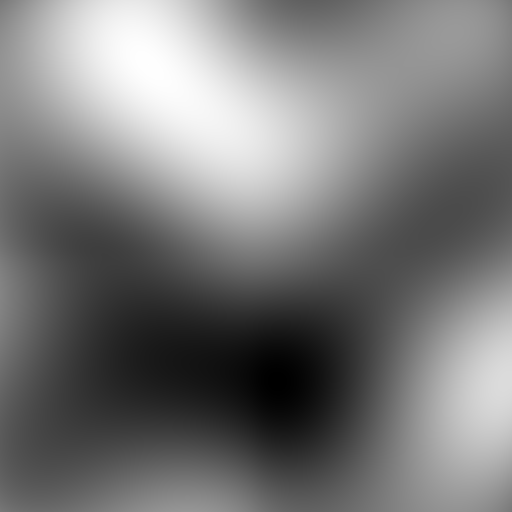

tensor([[0.4766, 0.4796, 0.4827,  ..., 0.4838, 0.4802, 0.4765],
        [0.4799, 0.4829, 0.4861,  ..., 0.4861, 0.4825, 0.4788],
        [0.4832, 0.4862, 0.4893,  ..., 0.4883, 0.4847, 0.4810],
        ...,
        [0.4633, 0.4607, 0.4582,  ..., 0.4887, 0.4850, 0.4811],
        [0.4668, 0.4642, 0.4616,  ..., 0.4863, 0.4826, 0.4788],
        [0.4703, 0.4677, 0.4652,  ..., 0.4840, 0.4803, 0.4765]])
tensor(0.) tensor(1.) torch.Size([512, 512])


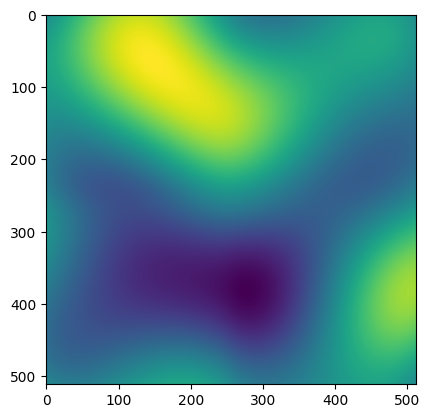

In [155]:
start = time.time()
noise = perlin_noise(grid_shape=(2,2), out_shape=(512, 512))
end = time.time()
noise = (noise - noise.min()) / (noise.max() - noise.min())
print(end - start, "time")
display(to_pil_image(noise))
print(noise)
print(noise.min(), noise.max(), noise.shape)

plt.imshow(noise)

In [126]:
from perlin_noise import PerlinNoise
import matplotlib.pyplot as plt

noise = PerlinNoise(octaves=2, seed=1)
xpix, ypix = 500, 500
pic = [[noise([i/xpix, j/ypix]) for j in range(xpix)] for i in range(ypix)]

plt.imshow(pic, cmap='gray')
plt.show()

pic = np.array(pic)
pic = torch.tensor(pic)
print(pic.min(), pic.max(), pic.shape)
display(to_pil_image(pic+ 0.5))

ImportError: cannot import name 'PerlinNoise' from 'perlin_noise' (/home/lukovdg1/.conda/envs/control-v11/lib/python3.8/site-packages/perlin_noise/__init__.py)

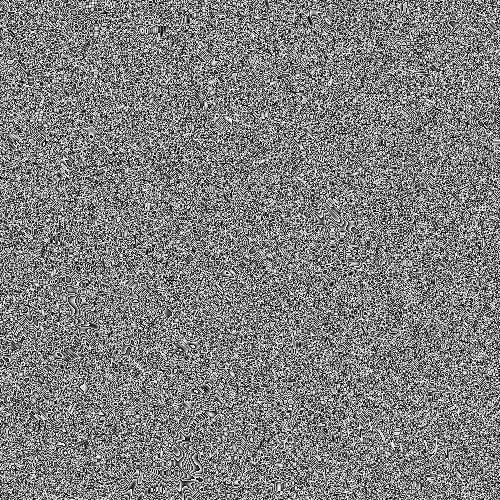

In [57]:
import opensimplex
opensimplex.seed(1234)
n = opensimplex.noise2array(x=np.linspace(0, 10, 500), y=np.linspace(0, 10, 500))
display(to_pil_image(torch.tensor(n * 255)))

In [107]:
import torch
import math

def rand_perlin_2d(shape, res, fade = lambda t: 6*t**5 - 15*t**4 + 10*t**3):
    delta = (res[0] / shape[0], res[1] / shape[1])
    d = (shape[0] // res[0], shape[1] // res[1])
    
    grid = torch.stack(torch.meshgrid(torch.arange(0, res[0], delta[0]), torch.arange(0, res[1], delta[1])), dim = -1) % 1
    angles = 2*math.pi*torch.rand(res[0]+1, res[1]+1)
    gradients = torch.stack((torch.cos(angles), torch.sin(angles)), dim = -1)
    
    tile_grads = lambda slice1, slice2: gradients[slice1[0]:slice1[1], slice2[0]:slice2[1]].repeat_interleave(d[0], 0).repeat_interleave(d[1], 1)
    dot = lambda grad, shift: (torch.stack((grid[:shape[0],:shape[1],0] + shift[0], grid[:shape[0],:shape[1], 1] + shift[1]  ), dim = -1) * grad[:shape[0], :shape[1]]).sum(dim = -1)
    
    n00 = dot(tile_grads([0, -1], [0, -1]), [0,  0])
    n10 = dot(tile_grads([1, None], [0, -1]), [-1, 0])
    n01 = dot(tile_grads([0, -1],[1, None]), [0, -1])
    n11 = dot(tile_grads([1, None], [1, None]), [-1,-1])
    t = fade(grid[:shape[0], :shape[1]])
    return math.sqrt(2) * torch.lerp(torch.lerp(n00, n10, t[..., 0]), torch.lerp(n01, n11, t[..., 0]), t[..., 1])

def rand_perlin_2d_octaves(shape, res, octaves=1, persistence=0.5):
    noise = torch.zeros(shape)
    frequency = 1
    amplitude = 1
    for _ in range(octaves):
        noise += amplitude * rand_perlin_2d(shape, (frequency*res[0], frequency*res[1]))
        frequency *= 2
        amplitude *= persistence
    return noise

0.7148749828338623 time


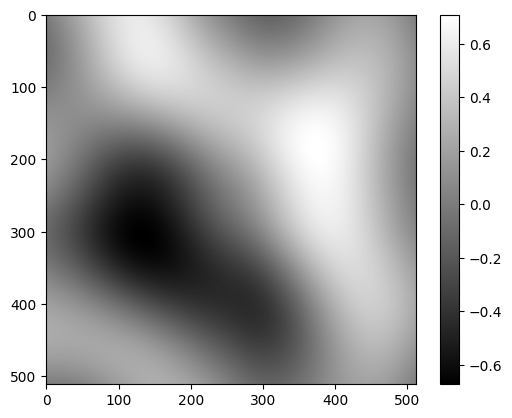

In [129]:
import matplotlib.pyplot as plt

start = time.time()
noise = rand_perlin_2d((512, 512), (2, 2))
end = time.time()
print(end - start, "time")
plt.figure()
plt.imshow(noise, cmap='gray', interpolation='lanczos')
plt.colorbar()

# noise = rand_perlin_2d_octaves((256, 256), (4, 4), 5)
# plt.figure()
# plt.imshow(noise, cmap='gray', interpolation='lanczos')
# plt.colorbar()

In [111]:
# ANALYZE GENERATIONS

In [21]:
genpath = "/USERSPACE/lukovdg1/controlnet11/checkpoints_vp/v1/checkpoints_coco_global_v1_exp_1/generated_clearshapes.pkl_hardblur_r20_14/outbatches.pkl"
outbatches = pkl.load(open(genpath, "rb"))

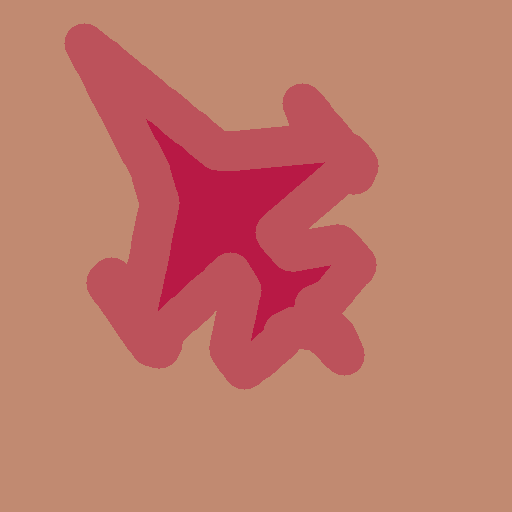

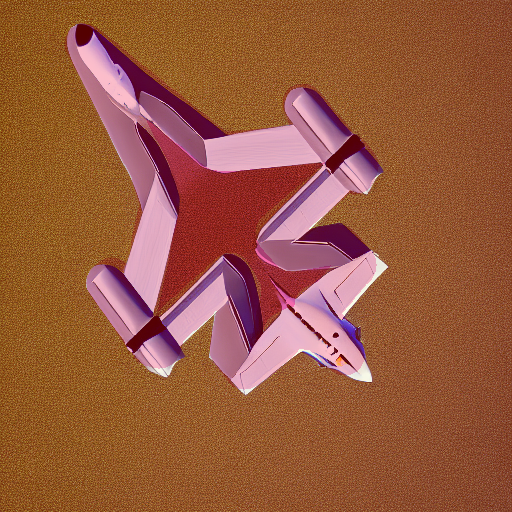

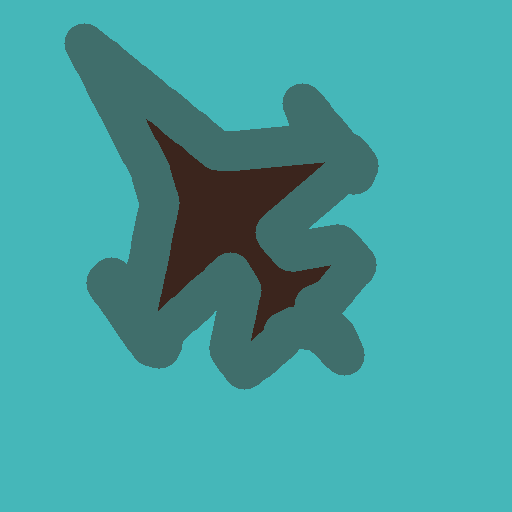

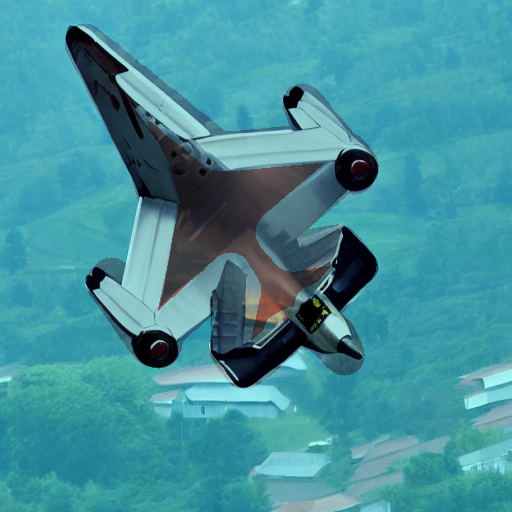

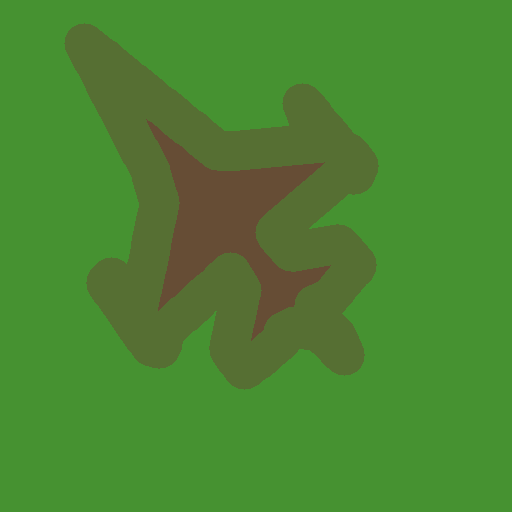

...

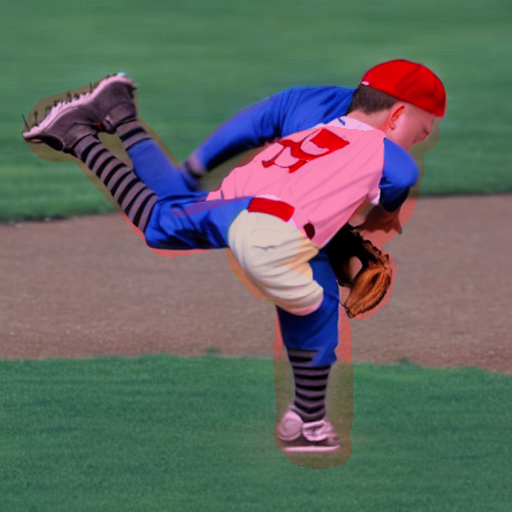

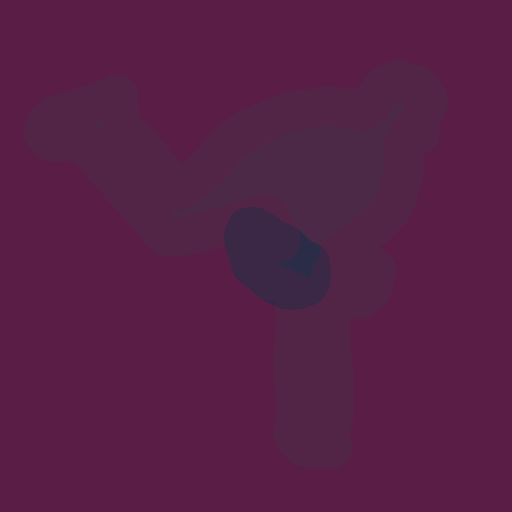

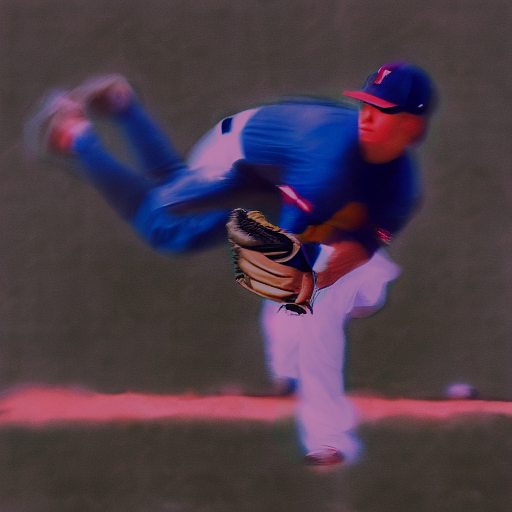

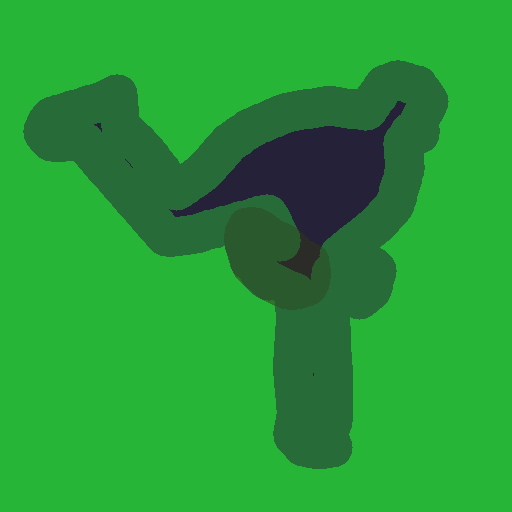

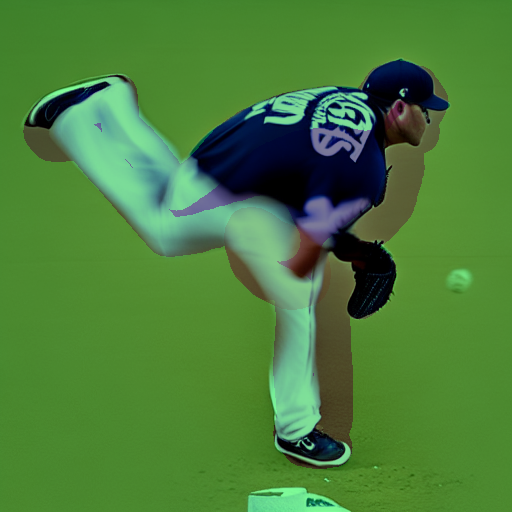

In [22]:
for batch in outbatches:
    for example in batch:
        display(example.seg_data2)
        # display(example.load_image())
        # display_example(example)
        display(blend(example.load_image(), example.seg_data2))
        

In [267]:
print(len(ds.examples[2][1]))

7360


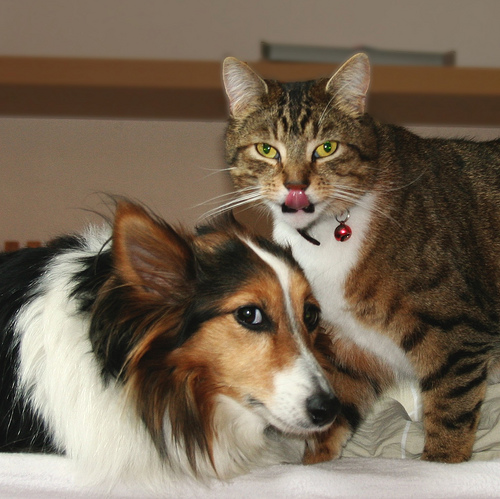

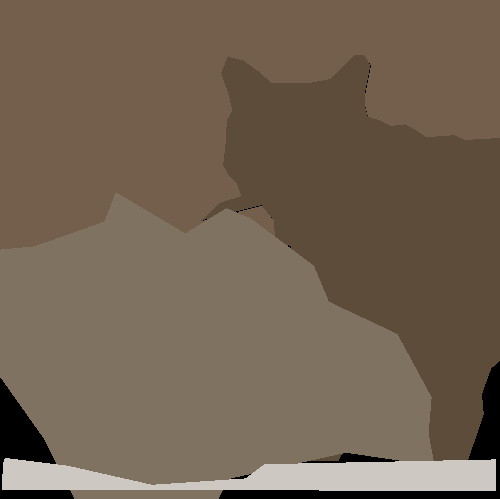

{
    "3755100": {
        "category_id": 17,
        "caption": "cat"
    },
    "6320768": {
        "category_id": 18,
        "caption": "dog"
    },
    "12699853": {
        "category_id": 65,
        "caption": "bed"
    },
    "4939635": {
        "category_id": 199,
        "caption": "wall"
    }
}
500 499
(499, 499)
(512, 512)
500 499
(499, 499)
(512, 512)
3755100 swapping: {'category_id': 17, 'caption': 'cat'} --> dog
6320768 swapping: {'category_id': 18, 'caption': 'dog'} --> cat


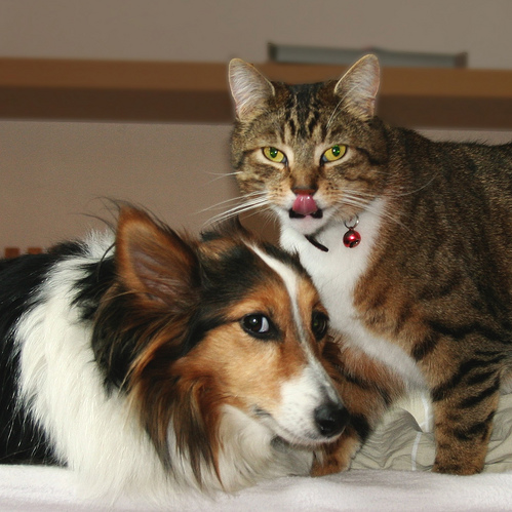

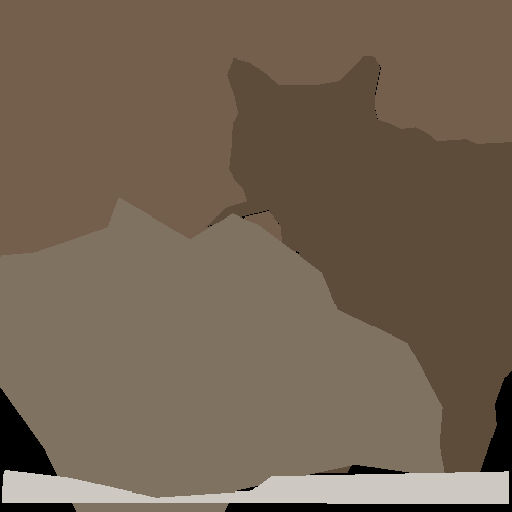

{
    "3755100": {
        "category_id": 17,
        "caption": "dog"
    },
    "6320768": {
        "category_id": 18,
        "caption": "cat"
    },
    "12699853": {
        "category_id": 65,
        "caption": "bed"
    },
    "4939635": {
        "category_id": 199,
        "caption": "wall"
    }
}


In [8]:
catdogexample = deepcopy(ds.examples[0][1][1])
display_example(catdogexample)

catdog1, catdog2 = prep_dev_ex(catdogexample, caption="a brown dog sitting next to a grey cat", swaps={"cat": "dog", "dog": "cat"})
display_example(catdog2)